In [1]:
import argparse
import numpy as np
import os
import sys
import time
import math
import matplotlib.pyplot as plt
from tqdm import tqdm
import warnings

import torch
import torch.nn as nn
import torchvision
from torchvision import datasets
from torchvision import transforms as T
from torchvision.utils import save_image, make_grid

from scripts.nets.vae_unet import VAEUnet
from scripts.nets.unet import Unet
from scripts.diffusion import Degradation, Trainer, Sampler, ExponentialMovingAverage
from scripts.utils import load_dataset, plot_degradation, create_dirs, save_video, save_single_imgs, save_gif, MyCelebA


import ipywidgets as widgets
from IPython.display import display

import torch.multiprocessing as mp
mp.set_start_method('spawn', force=True)

# Check if ipykernel is running to check if we're working locally or on the cluster
import sys
if 'ipykernel' in sys.modules:
    sys.argv = ['']

In [5]:

load = "vae"
final = False

if load == "vae":
    prediction = "vxt"
    degradation = "black_pixelation"
    ris_noise = 'store_true'
    add_noise = 'store_true'
    vae = 'store_false'
    manual_extension = '_pixelvcd'
    autoencoder = 'store_true'
    multiscale_vae = 'store_true'
    noise_scale = 0.0025
    timesteps = 8
    min_t2_step = 1
    cold_perturb = 'store_true'
    dim = 64

elif load == "risannen":
    prediction = "xt"
    degradation = "black_blur"
    add_noise = 'store_true'
    ris_noise = 'store_false'
    vae = 'store_true'
    manual_extension = '_risannen'
    multiscale_vae = 'store_true'
    autoencoder = 'store_true'
    noise_scale = 0.01
    timesteps = 200
    min_t2_step = 1
    cold_perturb = 'store_true'
    dim = 128


elif load == "bansal":
    prediction = "residual"
    degradation = "noise"
    ris_noise = 'store_true'
    add_noise = 'store_true'
    vae = 'store_true'
    manual_extension = '_ddpm'
    multiscale_vae = 'store_true'
    autoencoder = 'store_true'
    noise_scale = 0.0075
    timesteps = 200
    min_t2_step = 1
    cold_perturb = 'store_true'
    dim = 128

elif load == 'manual':
    prediction = "x0"
    degradation = "black_blur"
    ris_noise = 'store_true'
    add_noise = 'store_true'
    vae = 'store_false'
    manual_extension = '_vaenoise'
    autoencoder = 'store_true'
    multiscale_vae = 'store_true'
    noise_scale = 0.0075
    timesteps = 200
    min_t2_step = 50
    cold_perturb = 'store_true'
    dim = 128




parser = argparse.ArgumentParser(description='Diffusion Models')

# General Diffusion Parameters
parser.add_argument('--timesteps', '--t', type=int, default=timesteps, help='Degradation timesteps')
parser.add_argument('--prediction', '--pred', type=str, default=prediction, help='Prediction method, choose one of [x0, xt, residual]')
parser.add_argument('--dataset', type=str, default='afhq', help='Dataset to run Diffusion on. Choose one of [mnist, cifar10, celeba, lsun_churches]')
parser.add_argument('--degradation', '--deg', type=str, default=degradation, help='Degradation method')
parser.add_argument('--batch_size', '--b', type=int, default=64, help='Batch size')
parser.add_argument('--dim', '--d', type=int , default=dim, help='Model dimension')
parser.add_argument('--lr', type=float, default=2e-4, help='Learning rate')
parser.add_argument('--epochs', '--e', type=int, default=20, help='Number of Training Epochs')
parser.add_argument('--noise_schedule', '--sched', type=str, default='cosine', help='Noise schedule')
parser.add_argument('--loss_weighting', action='store_true', help='Whether to use weighting for reconstruction loss')
parser.add_argument('--var_sampling_step', type=int, default = 1, help='How to sample var timestep model - int > 0 indicates t difference to predict, -1 indicates x0 prediction')
parser.add_argument('--min_t2_step', type=int, default=min_t2_step, help='With what min step size to discretize t2 in variational timestep model')
parser.add_argument('--baseline', '--base', type=str, default='xxxx', help='Whether to run a baseline model - Risannen, Bansal, VAE')
parser.add_argument('--multiscale_vae', action=multiscale_vae, help='Whether to use multiscale vae encoder instead of normal vae encoder')
parser.add_argument('--autoencoder', action=autoencoder, help='Whether to use autoencoder instead of vae encoder')
parser.add_argument('--kl_annealing', type=int, default=10000, help='For how many iterations to anneal KL loss')
parser.add_argument('--cold_perturb', action=cold_perturb, help='Using cold perturbation')

# Noise Injection Parameters
parser.add_argument('--vae', action=vae, help='Whether to use VAE Noise injections')
parser.add_argument('--vae_beta', type=float, default = 0.001, help='Trade-off parameter for weight of Reconstruction and KL Div')
parser.add_argument('--latent_dim', type=int, default=512, help='Which dimension the VAE latent space is supposed to have')
parser.add_argument('--ris_noise', action=ris_noise, help='Whether to add noise Risannen et al. style')
parser.add_argument('--add_noise', action=add_noise, help='Whether to add noise somewhere in the process')
parser.add_argument('--break_symmetry', action='store_true', help='Whether to add noise to xT Bansal et al. style')
parser.add_argument('--noise_scale', type=float, default = noise_scale, help='How much Noise to add to the input')
parser.add_argument('--vae_loc', type=str, default = 'emb', help='Where to inject VAE Noise. One of [start, bottleneck, emb].')
parser.add_argument('--vae_inject', type=str, default = 'concat', help='How to inject VAE Noise. One of [concat, add].')
parser.add_argument('--xt_dropout', type=float, default = 0, help='How much of xt is dropped out at every step (to foster reliance on VAE injections)')

# Housekeeping Parameters
parser.add_argument('--load_checkpoint', action='store_true', help='Whether to try to load a checkpoint')
parser.add_argument('--sample_interval', type=int, help='After how many epochs to sample', default=1)
parser.add_argument('--n_samples', type=int, default=30, help='Number of samples to generate')
parser.add_argument('--fix_sample', action='store_false', help='Whether to fix x_T for sampling, to see sample progression')
parser.add_argument('--skip_ema', action='store_true', help='Whether to skip model EMA')
parser.add_argument('--model_ema_decay', type=float, default=0.997, help='Model EMA decay')
parser.add_argument('--cluster', action='store_true', help='Whether to run script locally')
parser.add_argument('--skip_wandb', action='store_true', help='Whether to skip wandb logging')
parser.add_argument('--verbose', '--v', action='store_true', help='Verbose mode')

parser.add_argument('--test_run', action='store_true', help='Whether to test run the pipeline')

args = parser.parse_args()

args.num_downsamples = 2 if args.dataset == 'mnist' else 3
args.device = 'cuda' if torch.cuda.is_available() else 'cpu'

if 'mnist' in args.dataset:
    args.image_size = 28
elif args.dataset == 'cifar10':
    args.image_size = 32
elif args.dataset == 'afhq':
    args.image_size = 64

if args.vae:
    print("Using VAE Noise Injections")
    #assert not args.add_noise, "Cannot use VAE and add noise at the same time"
else:
    if args.add_noise:
        print("Using Risannen Noise Injections")
    else:
        print("Using Normal U-Net")

if not args.cluster:
    print("Running locally, Cluster =", args.cluster)
    if args.device == 'cuda':
        warnings.warn('Consider running model on cluster-scale if CUDA is available')

if args.test_run:
    print("Running Test Run with only one iter per epoch")

print("Device: ", args.device)


kwargs = vars(args)

trainloader, valloader = load_dataset(kwargs['batch_size'], kwargs['dataset'])

x, _ = next(iter(trainloader))   
channels = x[0].shape[0]

# Model Configuration
if 'mnist' in kwargs['dataset']:
    attention_levels = (2,)
    ch_mult = (1,2,2)
    num_res_blocks = 2
elif kwargs['dataset'] == 'cifar10':
    attention_levels = (2,3)
    ch_mult = (1, 2, 2, 2)
    num_res_blocks = 4
elif kwargs['dataset'] == 'afhq':
    attention_levels = (2,3)
    ch_mult = (1, 2, 3, 4)
    num_res_blocks = 2
elif kwargs['dataset'] == 'celeba':
    attention_levels = (2,3)
    ch_mult = (1, 2, 2, 2)
elif kwargs['dataset'] == 'lsun_churches':
    attention_levels = (2,3,4)
    ch_mult = (1, 2, 3, 4, 5)
    num_res_blocks = 4


# Define Model
if kwargs['vae']:

    print(kwargs['dim'])

    # Risannen Version
    unet = VAEUnet(image_size=kwargs["image_size"],
                    in_channels=channels,
                    dim=kwargs['dim'],
                    num_res_blocks=num_res_blocks,
                    attention_levels=attention_levels,
                    dropout=0,
                    ch_mult=ch_mult,
                    latent_dim = kwargs['latent_dim'],
                    add_noise=kwargs['add_noise'],
                    noise_scale= kwargs['noise_scale'],
                    var_timestep=True if kwargs['prediction'] in ['xt', 'vxt'] else False,
                    vae_loc = kwargs['vae_loc'],
                    vae_inject = kwargs['vae_inject'],
                    xt_dropout = kwargs['xt_dropout'])

else:

    unet = Unet(image_size=kwargs["image_size"],
                        in_channels=channels,
                        dim=kwargs['dim'],
                        num_res_blocks=num_res_blocks,
                        attention_levels=attention_levels,
                        dropout=0,
                        ch_mult=ch_mult,
                        add_noise=kwargs['add_noise'],
                        noise_scale= kwargs['noise_scale'],
                        t2=True if kwargs['prediction'] in ['xt', 'vxt'] else False)

if kwargs['autoencoder']:

    from scripts.nets.conditional_unet import AEUnet

    unet = AEUnet(image_size=kwargs["image_size"],
                    in_channels=channels,
                    dim=kwargs['dim'],
                    num_res_blocks=num_res_blocks,
                    attention_levels=attention_levels,
                    dropout=0,
                    ch_mult=ch_mult,
                    latent_dim = kwargs['latent_dim'],
                    add_noise=kwargs['add_noise'],
                    noise_scale= kwargs['noise_scale'],
                    var_timestep=True if kwargs['prediction'] in ['xt', 'vxt'] else False,
                    vae_loc = kwargs['vae_loc'],
                    vae_inject = kwargs['vae_inject'],
                    xt_dropout = kwargs['xt_dropout'])
    

#unet = nn.DataParallel(unet)


Using VAE Noise Injections
Running locally, Cluster = False
Device:  cpu
64
Current Resolution:  8
VAE Projection with target dim:  512


In [11]:

# Define Trainer and Sampler
trainer = Trainer(model = unet, **kwargs)
sampler = Sampler(**kwargs)

# Fit GMM for cold sampling in deblurring diffusion
# sampler.fit_gmm(trainloader, clusters=1)

# Fix x_T for sampling
if kwargs['fix_sample']:
    sampler.sample_x_T(kwargs['n_samples'], channels, kwargs['image_size'])

# Create directories
imgpath, modelpath = create_dirs(**kwargs)

# imgpath = imgpath.replace('imgs', 'imgs/control').split('run')[0]
# imgpath = os.path.join(imgpath, 'control')
# if not os.path.exists(imgpath):
#     os.makedirs(imgpath)

ema_flag = '' if kwargs['skip_ema'] else '_ema'
final_flag = '/final' if final else ''

# Load Checkpoint
try:
    chkpt = torch.load(os.path.join(f"./models/models_to_test/{kwargs['dataset']}{final_flag}/{degradation}", f"chpkt_{kwargs['dim']}_{kwargs['timesteps']}_{kwargs['prediction']}{ema_flag}{manual_extension}.pt"), map_location=kwargs['device'])
    # drop keys that are not in model state dict
    chkpt['model_state_dict'] = {k.replace('module.',''): v for k, v in chkpt['model_state_dict'].items()}
    chkpt['model_state_dict'] = {k: v for k, v in chkpt['model_state_dict'].items() if k in unet.state_dict()}
    #chkpt['optimizer_state_dict'] = {k: v for k, v in chkpt['optimizer_state_dict'].items() if k in trainer.optimizer.state_dict()}
    #chkpt['ema_state_dict'] = {k: v for k, v in chkpt['ema_state_dict'].items() if k in trainer.model_ema.state_dict()}
    trainer.model.load_state_dict(chkpt['model_state_dict'])
    #trainer.optimizer.load_state_dict(chkpt['optimizer_state_dict'])
    trainer.model_ema.load_state_dict(chkpt['ema_state_dict'])
        
    # Replace model params with EMA params 
    trainer.model_ema.copy_to(trainer.model.parameters()) # Copy EMA params to model
    
    print("Checkpoint loaded, model trained until epoch", chkpt['epoch'])
except Exception as e:
    print(os.path.join(f"./models/models_to_test/{kwargs['dataset']}{final_flag}/{degradation}", f"chpkt_{kwargs['dim']}_{kwargs['timesteps']}_{kwargs['prediction']}{ema_flag}{manual_extension}.pt"))
    raise ValueError("No checkpoint found, please choose pretrained variable timestep model to control VAE injections.")

# EMA Transfer
trainer.model.eval()
trainer.model_ema.copy_to(trainer.model.parameters()) # Copy EMA params to model for inference
print("EMA transferred to model")



x_T sampled and fixed
Checkpoint loaded, model trained until epoch 55
EMA transferred to model


In [15]:
x0_large = next(iter(trainloader))[0].to(kwargs['device'])
x02_large = next(iter(trainloader))[0].to(kwargs['device'])

x0 = x0_large[:kwargs['n_samples']]
x02 = x02_large[:kwargs['n_samples']]

In [12]:
class VAESampler():

    def __init__(self, trainer, **kwargs):
        self.model = trainer.model
        self.trainer = trainer
        self.timesteps = kwargs['timesteps']
        self.T = torch.full((kwargs['n_samples'],), self.timesteps-1, dtype=torch.long).to(kwargs['device'])
        self.xT = torch.zeros((kwargs['n_samples'], self.model.in_channels, kwargs['image_size'], kwargs['image_size']), device=kwargs['device']) 
        #self.xT = sampler.x_T[:kwargs['n_samples']]
        self.target_prior = torch.randn(kwargs['n_samples'], kwargs['latent_dim']).to(kwargs['device'])
        self.target_prior = self.target_prior[0, :].unsqueeze(0).repeat(kwargs['n_samples'], 1)
        self.source_prior = torch.randn(kwargs['n_samples'], kwargs['latent_dim']).to(kwargs['device'])
        self.sample_noise = torch.randn(kwargs['n_samples'], self.model.in_channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device']) * kwargs['noise_scale']
        self.add_noise = kwargs['add_noise']

        if kwargs['multiscale_vae']:
            self.target_prior = torch.randn((kwargs['n_samples'], len(self.model.channel_mult), kwargs['latent_dim'])).to(kwargs['device'])
            self.target_prior = self.target_prior[0, :].unsqueeze(0).repeat(kwargs['n_samples'], 1, 1)
            self.source_prior = torch.randn((kwargs['n_samples'], len(self.model.channel_mult), kwargs['latent_dim'])).to(kwargs['device'])

        self.dct = DCTBlurSampling(trainer.degradation.dct_blur.blur_sigmas, kwargs['image_size'], kwargs['device'])
        self.saved_priors = [None for _ in range(self.timesteps)]


    plt.figure(figsize=(20, 10))
    @torch.no_grad()
    def full_loop(self, step_size, injection_t = [200, 50], x0 = None, x02 = None, plot = True, accumulative = True, unblack = False, mp_interpolate = False, mp_factor = 0.5, bias = False, **kwargs):
        
        # if x02 is not None:
        #     self.xT = self.trainer.degradation.degrade(x02, self.T)

        xt = self.xT
        samples = torch.Tensor(xt[0:5].unsqueeze(0))
        
        skip_steps = step_size-1 if step_size == self.timesteps else step_size
        
        # # Fix sample Noise
        # if self.add_noise:
        #     self.model.sample_noise = self.sample_noise * self.model.noise_scale
        
        # Make accumulative injections, i.e., fix injection beginning to start
        if accumulative:
            if injection_t[0] != -1:
                injection_t[0] = 10


        # Loop differs from the sequential one, as we go back to t-1 at every step
        for i in tqdm(range(self.timesteps-1, -1, -skip_steps), total = self.timesteps // skip_steps, desc = f'Sampling Autoencoder for window {injection_t}'):
            
            t = torch.full((kwargs['n_samples'],), i, dtype=torch.long).to(kwargs['device'])
            t2 = torch.full((kwargs['n_samples'],), i-step_size, dtype=torch.long).to(kwargs['device'])
            #print(t[0].item(), t2[0].item())
            
            if t2[0].item() < 0: # Equals to x0 prediction
                t2 = torch.full((kwargs['n_samples'],), -1, dtype=torch.long).to(kwargs['device']) # t-1 to account for 0 indexing that the model is seeing during training

            # Inject source information in a certain t range
            # if x0 and / or x02 are not None, take the conditioning information from the encoded data,
            
            if i <= injection_t[0] and i >= injection_t[1]:
                if x02 is not None:
                    xt2 = self.trainer.degradation.degrade(x02, t)
                    cond = self.trainer.degradation.degrade(x02, t2)
                    #dummy_pred, _ = self.model(xt2, t, cond=cond, prior=None, t2=t2) # Dummy prediction to get the encoded VAE latent
                    #dummy_pred = self.model(xt2, t, cond=cond, prior=None, t2=t2) # Dummy prediction to get the encoded VAE latent
                    #prior = self.model.vae_noise.detach() # Get the latent code for the second image to inject it into the model at a certain timestep
                    #prior = self.model.vae_noise / kwargs['noise_scale']
                    prior = None
                else:
                    prior = self.source_prior
                    cond = None # No condition for the model, such that is has to use the prior
                
                if mp_interpolate and i <= injection_t[0] != 10:
                    prior = self.target_prior * mp_factor + self.source_prior * (1-mp_factor)
            else:
                if x0 is not None:
                    #if self.saved_priors[i] is None:
                    cond = self.trainer.degradation.degrade(x0, t2)
                    prior = None # No prior for the model, such that it has to use it's own z_sem
                    #dummypred, _ = self.model(xt, t, cond=cond, prior=prior, t2=t2)
                        # self.saved_priors[i] = self.model.vae_noise.detach() / kwargs['noise_scale']
                        # self.saved_priors[i] = self.saved_priors[i][0, :].unsqueeze(0).repeat(kwargs['n_samples'], 1)
                        # cond = None
                        # prior = self.saved_priors[i]

                    # else:
                    #     cond = None
                    #     prior = self.saved_priors[i]
                else:
                    cond = None
                    prior = self.target_prior




            # Sample New Noise every time
            #self.model.sample_noise = torch.randn_like(xt).to(xt.device) * self.model.noise_scale
            # if self.add_noise:
            #     xt = xt + self.sample_noise
                

            pred, _ = self.model(xt, t, cond=cond, prior=prior, t2=t2)
            #pred = self.model(xt, t, cond=cond, prior=prior, t2=t2)
            pred = pred.detach()
            global check 
            check = pred
            
            if kwargs['prediction'] == 'x0':
                xt_hat = self.trainer.degradation.degrade(pred, t)
                xtm1_hat = self.trainer.degradation.degrade(pred, t-1)
                xt = xt - xt_hat + xtm1_hat

            else:
                xtm1_model = xt + pred
                #xtm1_model = pred


                if bias:

                    # Calculcate reblurring for DCT
                    stdt = self.trainer.degradation.blur.dct_sigmas[t[0].item()] 
                    stdt2 = self.trainer.degradation.blur.dct_sigmas[t2[0].item()] if t2[0].item() != -1 else 0

                    # Manually calculating DCT timesteps
                    t_dct = torch.full((kwargs['n_samples'],), stdt**2/2, dtype=torch.float32)[:, None, None, None].to(kwargs['device'])
                    t2_dct = torch.full((kwargs['n_samples'],), stdt2**2/2, dtype=torch.float32)[:, None, None, None].to(kwargs['device'])
                    delta_t = t_dct - t2_dct

                    # Undo Blacking
                    blacking_coef = self.trainer.degradation.blacking_coefs[t2[0].item()] if t2[0].item() != -1 else 1
                    unblacked_xtm1_hat = xtm1_model / blacking_coef

                    # Reblur to t / t-1 from t2 and apply blacking
                    xt_hat = self.dct(unblacked_xtm1_hat, t=delta_t) 
                    xt_hat *= self.trainer.degradation.blacking_coefs[t[0].item()]

                    # Reblurring test
                    if x02 is not None:
                        test_xt = self.trainer.degradation.degrade(x02, t)
                        test_xt2 = self.trainer.degradation.degrade(x02, t2)
                        blacking_coef = trainer.degradation.blacking_coefs[t2[0].item()] if t2[0].item() != -1 else 1
                        test_xt2 = test_xt2 / blacking_coef
                        black_coef = self.trainer.degradation.blacking_coefs[t[0].item()] if t[0].item() != 0 else 1
                        test_xt_hat = self.dct(test_xt2, t=delta_t) * black_coef
                        # print(test_xt[0,0,0,:])
                        # print(test_xt2[0,0,0,:])
                        # print(test_xt_hat[0,0,0,:])
                        # print(delta_t[0].item())
                        #plt.subplot(1, 8, 8-t[0].item())
                        #plt.imshow(test_xt_hat[0].cpu().detach().numpy().transpose(1, 2, 0))
                        #assert torch.allclose(test_xt_hat, test_xt, atol=1e-3), f"Reblurring not working correctly, {test_xt[0]}, {test_xt_hat[0]}"

                    # Bias accounting as in Cold Diffusion
                    xtm1_bias = xt - xt_hat + xtm1_model
                    xtm1_model = xtm1_bias


                ## Unblacking
                if unblack:
                    black_coef = self.trainer.degradation.blacking_coefs[t-1] if t[0].item()!= 0 else 1
                    xtm1_model = xtm1_model / black_coef

                samples = torch.cat((samples, xtm1_model[0:5].unsqueeze(0)), dim=0)

                # Reblacking
                if unblack:
                    xtm1_model *= black_coef

                xt = xtm1_model

        if plot:
            #self.plot(xt)
            noise_flag = 'noise' if self.add_noise else 'no_noise'
            save_gif(samples[:,0,:,:], f'./imgs/experiment_imgs', nrow = 1, name = f"sample_seq_VAE_{noise_flag}.gif")

        return samples, xt
    



    def plot(self, input):
        plt.figure(figsize=(20, 10))
        grid = make_grid(input, nrow=10, padding=0)
        grid = torch.clamp(grid, 0, 1)
        plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
        plt.axis('off')
        plt.show()

trainer.model.noise_level = kwargs['noise_scale']
vae_sampler = VAESampler(trainer, **kwargs)

<Figure size 2000x1000 with 0 Axes>

# Unconditional Sampling

Sampling Autoencoder for window [100, -1]: 100%|██████████| 8/8 [00:03<00:00,  2.51it/s]


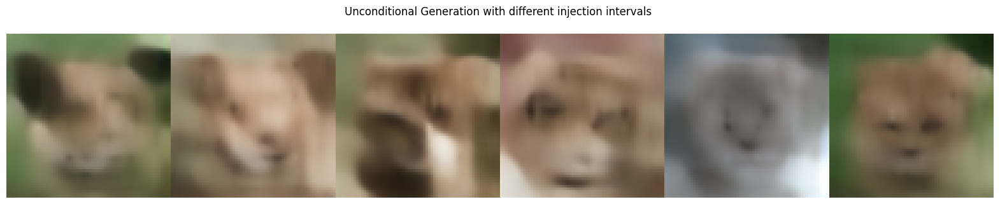

In [13]:
# vae_sampler.model.noise_scale = 0.01
kwargs['n_samples'] = 6
nrow = 6
vae_sampler = VAESampler(trainer, **kwargs)
vae_sampler.sample_noise *= 0

use_x0 = False
use_x02 = False
num_rows = 0
img_ind = 0

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    

step_size = 1
samples, xt = vae_sampler.full_loop(step_size, 
                                        injection_t = [100,-1], 
                                        x0 = x0,
                                        x02 = x02,
                                        plot = False, 
                                        accumulative = False,
                                        unblack=False,
                                        mp_interpolate=False,
                                        mp_factor=0.5,
                                        **kwargs)

# stack samples
#xt = torch.transpose(xt, 0, 1) # Transpose to switch cols and rows in the grid
xt = xt.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

plt.figure(figsize=(20, 10))
grid = make_grid(xt, nrow=nrow, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

# Generation Sequence

x_T sampled and fixed


Sampling Autoencoder for window [10, -1]: 100%|██████████| 8/8 [00:02<00:00,  2.74it/s]


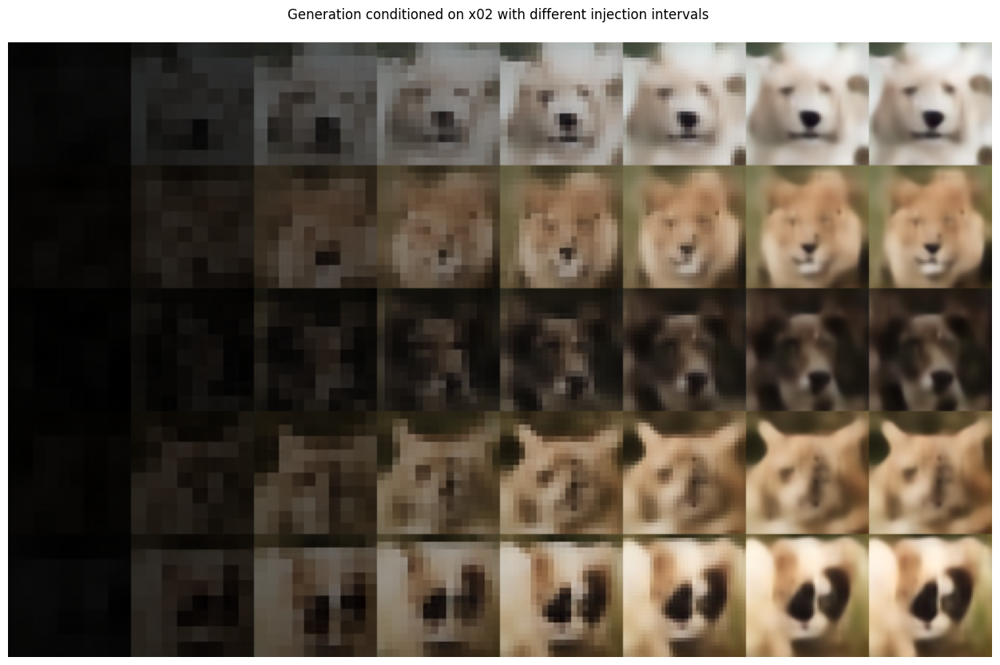

In [16]:
kwargs['n_samples'] = 5
sampler.sample_x_T(kwargs['n_samples'], channels, kwargs['image_size'])
vae_sampler = VAESampler(trainer, **kwargs)
#vae_sampler.sample_noise *= 0

use_x0 = True
use_x02 = True
img_ind = 7

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 1
samples, xt = vae_sampler.full_loop(step_size, 
                                        injection_t = [10,-1], 
                                        x0 = x0,
                                        x02 = x02,
                                        plot = False, 
                                        accumulative = False,
                                        unblack=False,
                                        mp_interpolate=False,
                                        mp_factor=0.5,
                                        bias = False,
                                        **kwargs)

# stack samples
samples = samples[1:]
nrow = samples.shape[0]
samples = torch.transpose(samples, 0, 1) # Transpose to switch cols and rows in the grid
samples = samples.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])


plt.figure(figsize=(20, 10))
grid = make_grid(samples, nrow=nrow, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

x_T sampled and fixed


Sampling Autoencoder for window [10, -1]: 100%|██████████| 8/8 [00:15<00:00,  1.97s/it]


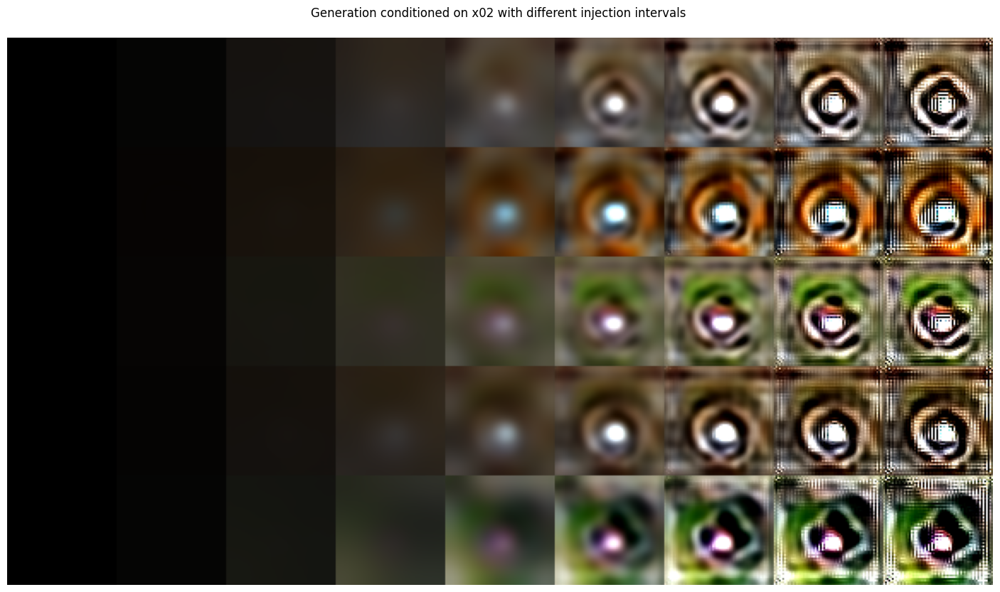

In [36]:
kwargs['n_samples'] = 5
sampler.sample_x_T(kwargs['n_samples'], channels, kwargs['image_size'])
vae_sampler = VAESampler(trainer, **kwargs)
#vae_sampler.sample_noise *= 0

use_x0 = True
use_x02 = True
img_ind = 1

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 1
samples, xt = vae_sampler.full_loop(step_size, 
                                        injection_t = [10,-1], 
                                        x0 = x0,
                                        x02 = x02,
                                        plot = False, 
                                        accumulative = False,
                                        unblack=False,
                                        mp_interpolate=False,
                                        mp_factor=0.5,
                                        bias = False,
                                        **kwargs)

# stack samples
#samples = samples[1:]
nrow = samples.shape[0]
samples = torch.transpose(samples, 0, 1) # Transpose to switch cols and rows in the grid
samples = samples.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

plt.figure(figsize=(20, 10))
grid = make_grid(samples, nrow=nrow, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

# Interpolation

Sampling Autoencoder for window [40, -1]: 100%|██████████| 100/100 [00:30<00:00,  3.30it/s]


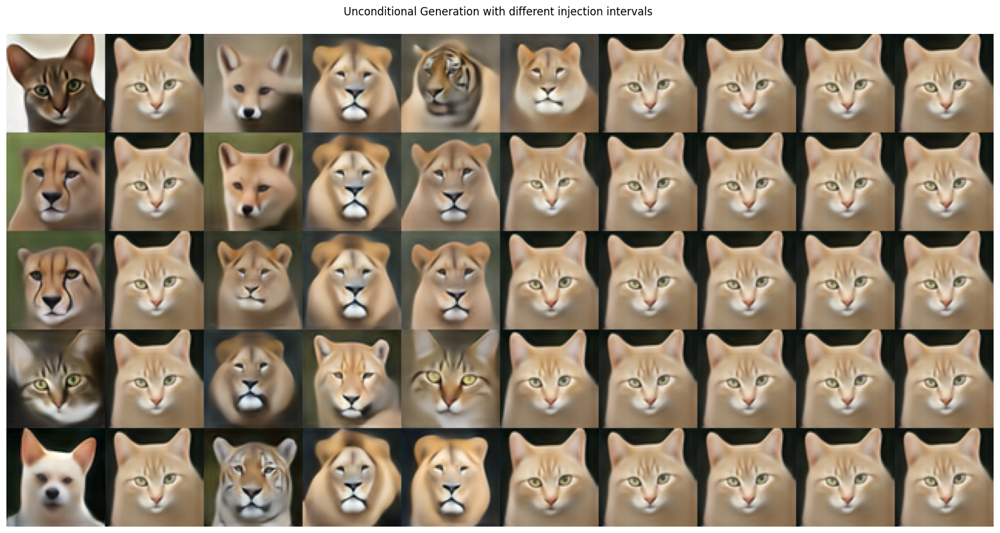

In [6]:
# vae_sampler.model.noise_scale = 0.01
kwargs['degradation'] = 'black_blur'
trainer = Trainer(model = unet, **kwargs)
kwargs['n_samples'] = 5
n_rows = kwargs['n_samples']
vae_sampler = VAESampler(trainer, **kwargs)
vae_sampler.sample_noise *= 0
vae_sampler.model.noise_level = 0


use_x0 = False
use_x02 = False
num_rows = 0
img_ind = 9

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 1
windows = [[100,-1], [-1,100], [100, 95], [95, 90], [90, 80], [80, 70], [70, 60], [60, 50], [50, 40], [40, -1]]


for inject_interval in windows:
    
    samples, xt = vae_sampler.full_loop(step_size, 
                                        injection_t = inject_interval, 
                                        x0 = x0,
                                        x02 = x02,
                                        plot = False, 
                                        accumulative = False,
                                        unblack=False,
                                        mp_interpolate=False,
                                        mp_factor=0.3,
                                        **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])


plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

Sampling Autoencoder for window [16, -1]: 100%|██████████| 100/100 [00:29<00:00,  3.37it/s]


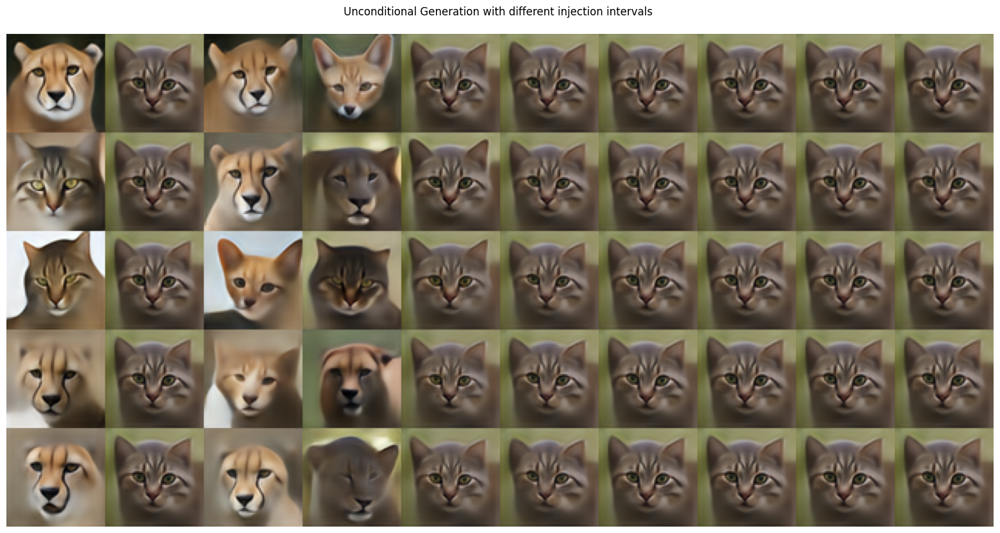

In [7]:
# vae_sampler.model.noise_scale = 0.01
kwargs['degradation'] = 'black_blur'
trainer = Trainer(model = unet, **kwargs)
kwargs['n_samples'] = 5
n_rows = kwargs['n_samples']
vae_sampler = VAESampler(trainer, **kwargs)
vae_sampler.sample_noise *= 0
vae_sampler.model.noise_level = 0


use_x0 = False
use_x02 = False
num_rows = 0
img_ind = 9

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 1
windows = [[100,-1], [-1,100], [100, 88], [88, 76], [76, 64], [64, 52], [52, 40], [40, 28], [28, 16], [16, -1]]


for inject_interval in windows:
    
    samples, xt = vae_sampler.full_loop(step_size, 
                                        injection_t = inject_interval, 
                                        x0 = x0,
                                        x02 = x02,
                                        plot = False, 
                                        accumulative = False,
                                        unblack=False,
                                        mp_interpolate=False,
                                        mp_factor=0.3,
                                        **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])


plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

Sampling Autoencoder for window [1, -1]: 100%|██████████| 8/8 [00:03<00:00,  2.39it/s]


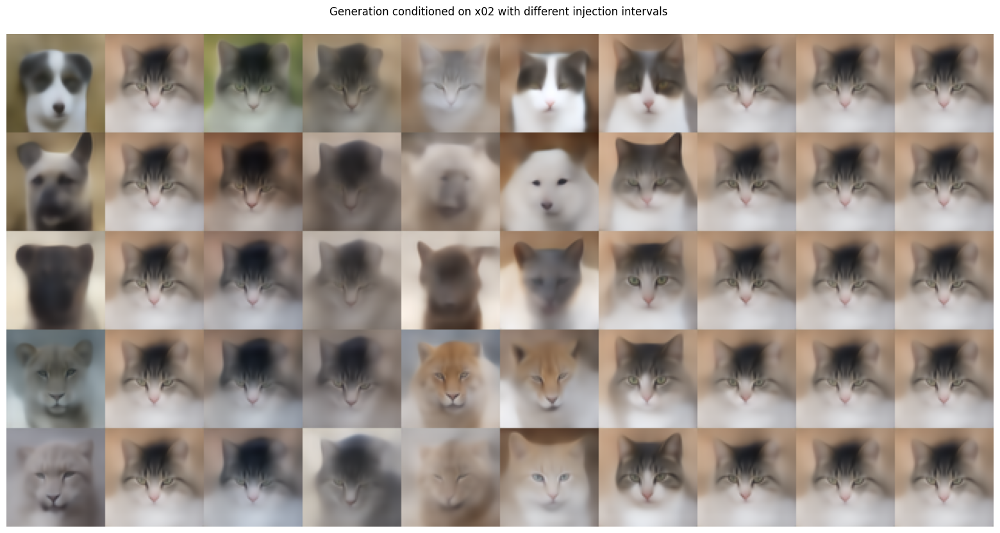

In [84]:
# vae_sampler.model.noise_scale = 0.01
kwargs['degradation'] = 'black_blur'
trainer = Trainer(model = unet, **kwargs)
kwargs['n_samples'] = 5
n_rows = kwargs['n_samples']
vae_sampler = VAESampler(trainer, **kwargs)
vae_sampler.sample_noise *= 0
vae_sampler.model.noise_level = 0


use_x0 = True
use_x02 = True
num_rows = 0
img_ind = 9

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 1
windows = [[8,-1], [-1,8], [8, 7], [7, 6], [6, 5], [5, 4], [4, 3], [3, 2], [2, 1], [1, -1]]


for inject_interval in windows:
    
    samples, xt = vae_sampler.full_loop(step_size, 
                                        injection_t = inject_interval, 
                                        x0 = x0,
                                        x02 = x02,
                                        plot = False, 
                                        accumulative = False,
                                        unblack=False,
                                        mp_interpolate=False,
                                        mp_factor=0.3,
                                        **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])


plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

# Generative Control

Sampling Autoencoder for window [1, -1]: 100%|██████████| 10/10 [00:07<00:00,  1.34it/s]


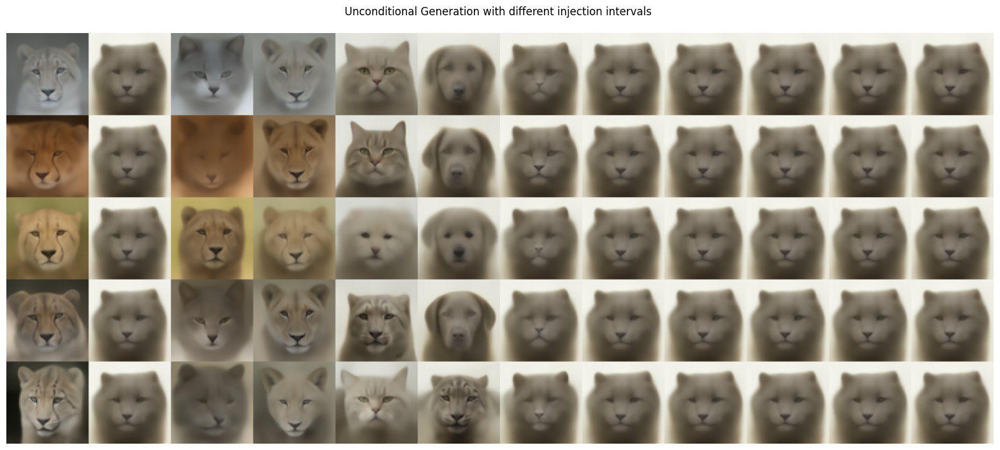

In [262]:
# vae_sampler.model.noise_scale = 0.01
kwargs['n_samples'] = 5
n_rows = kwargs['n_samples']
vae_sampler = VAESampler(trainer, **kwargs)
vae_sampler.sample_noise *= 0

use_x0 = False
use_x02 = False
num_rows = 0
img_ind = 1

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 1
windows = [[10,-1], [-1,10], [10,9], [9,8], [8, 7], [7, 6], [6, 5], [5, 4], [4, 3], [3, 2], [2, 1], [1, -1]]

for inject_interval in windows:
    
    samples, xt = vae_sampler.full_loop(step_size, 
                                          injection_t = inject_interval, 
                                          x0 = x0,
                                          x02 = x02,
                                          plot = False, 
                                          accumulative = False,
                                          unblack=False,
                                          mp_interpolate=True,
                                          mp_factor=0.3,
                                          **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

Sampling Autoencoder for window [1, -1]: 100%|██████████| 10/10 [00:07<00:00,  1.34it/s]


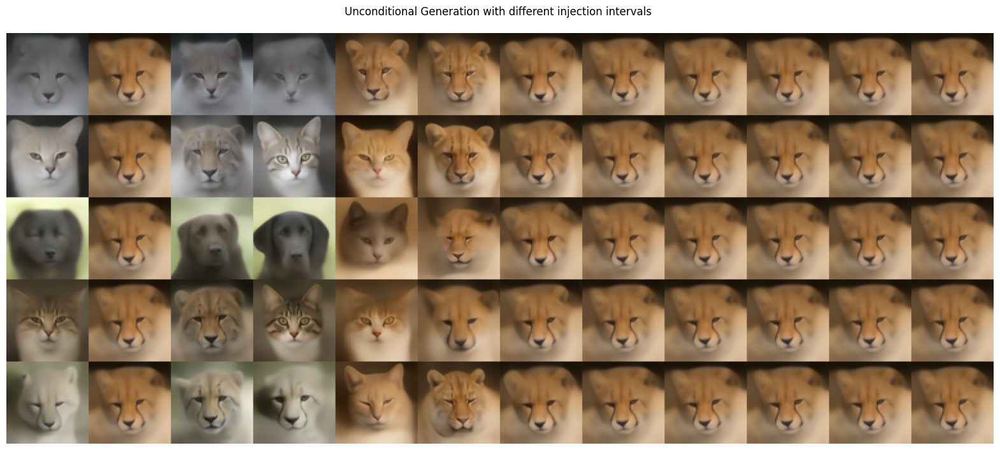

In [79]:
# vae_sampler.model.noise_scale = 0.01
kwargs['n_samples'] = 5
n_rows = kwargs['n_samples']
vae_sampler = VAESampler(trainer, **kwargs)
vae_sampler.sample_noise *= 0

use_x0 = False
use_x02 = False
num_rows = 0
img_ind = 1

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 1
windows = [[10,-1], [-1,10], [10,9], [9,8], [8, 7], [7, 6], [6, 5], [5, 4], [4, 3], [3, 2], [2, 1], [1, -1]]

for inject_interval in windows:
    
    samples, xt = vae_sampler.full_loop(step_size, 
                                          injection_t = inject_interval, 
                                          x0 = x0,
                                          x02 = x02,
                                          plot = False, 
                                          accumulative = False,
                                          unblack=False,
                                          mp_interpolate=True,
                                          mp_factor=0.2,
                                          **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

# VWD Noise Assessment

Sampling Autoencoder for window [200, -1]: 100%|██████████| 10/10 [00:06<00:00,  1.53it/s]


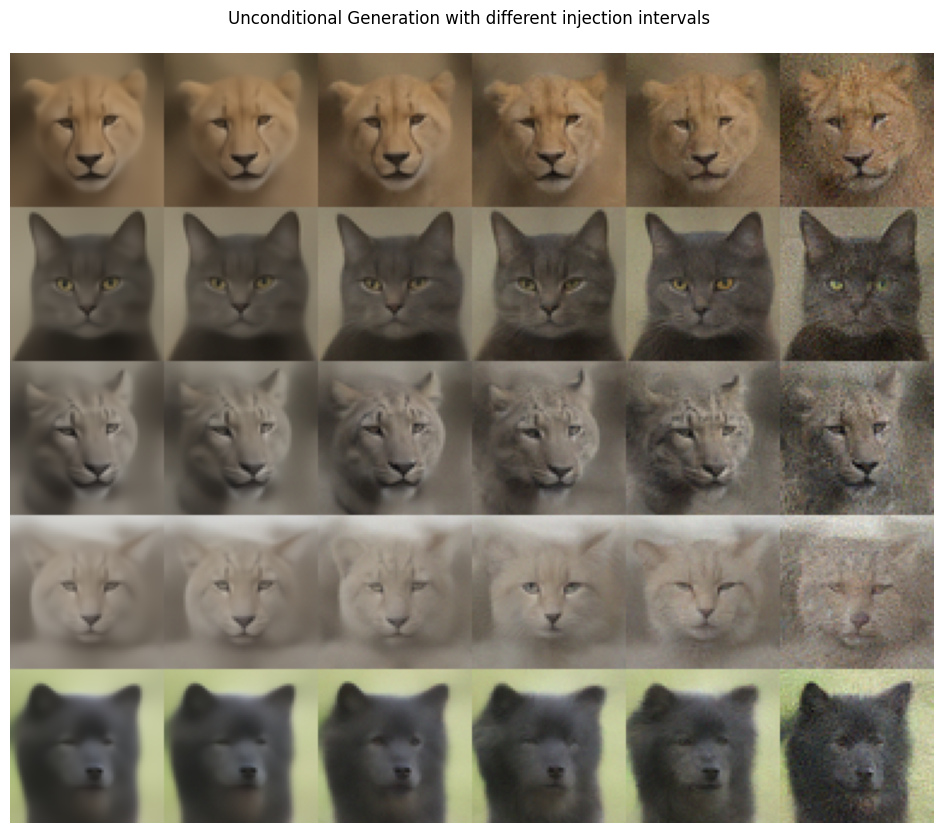

In [39]:
# vae_sampler.model.noise_scale = 0.01
kwargs['n_samples'] = 5
kwargs['noise_scale'] = 0.0005
n_rows = kwargs['n_samples']
#vae_sampler = VAESampler(trainer, **kwargs)
vae_sampler.sample_noise *= 0

use_x0 = False
use_x02 = False
num_rows = 0
img_ind = 1

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    

#sample_noise = torch.randn(kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device']) * kwargs['noise_scale']

step_size = 1
scales = [0, 0.5, 1, 1.25, 1.5, 2]
for noise_scale in scales:
    
    sample_noise = torch.randn(kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device']) * kwargs['noise_scale']

    vae_sampler.sample_noise = sample_noise * noise_scale
    
    samples, xt = vae_sampler.full_loop(step_size, 
                                          injection_t = [200, -1], 
                                          x0 = x0,
                                          x02 = x02,
                                          plot = False, 
                                          accumulative = False,
                                          unblack=False,
                                          mp_interpolate=True,
                                          mp_factor=0.2,
                                          **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

Sampling Autoencoder for window [200, -1]: 100%|██████████| 10/10 [00:06<00:00,  1.60it/s]


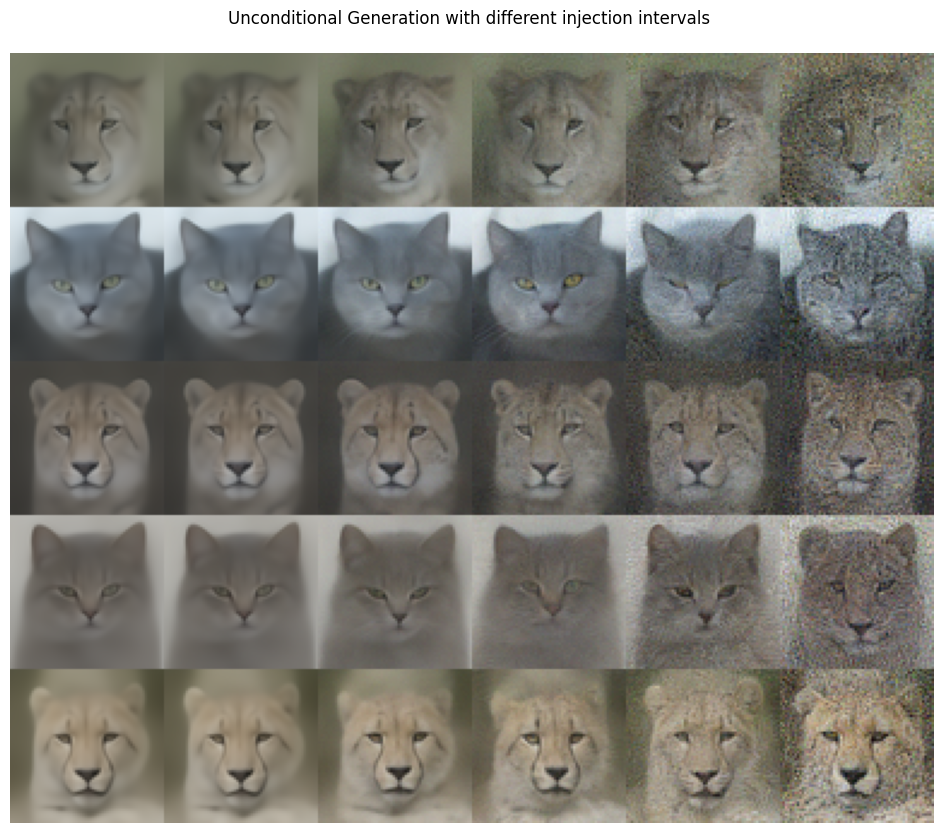

In [34]:
# vae_sampler.model.noise_scale = 0.01
kwargs['n_samples'] = 5
kwargs['noise_scale'] = 0.001
n_rows = kwargs['n_samples']
vae_sampler = VAESampler(trainer, **kwargs)
vae_sampler.sample_noise *= 0

use_x0 = False
use_x02 = False
num_rows = 0
img_ind = 1

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    

#sample_noise = torch.randn(kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device']) * kwargs['noise_scale']

step_size = 1
scales = [0, 0.1, 0.5, 0.75, 1, 1.25]
for noise_scale in scales:
    
    sample_noise = torch.randn(kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device']) * kwargs['noise_scale']

    vae_sampler.sample_noise = sample_noise * noise_scale
    
    samples, xt = vae_sampler.full_loop(step_size, 
                                          injection_t = [200, -1], 
                                          x0 = x0,
                                          x02 = x02,
                                          plot = False, 
                                          accumulative = False,
                                          unblack=False,
                                          mp_interpolate=True,
                                          mp_factor=0.2,
                                          **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

Sampling Autoencoder for window [10, -1]: 100%|██████████| 10/10 [00:06<00:00,  1.45it/s]


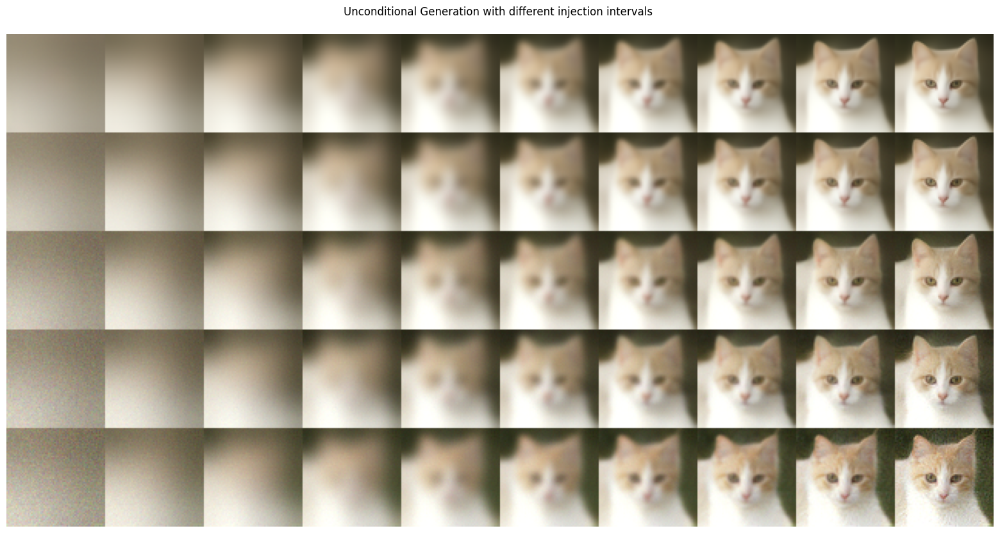

In [20]:
kwargs['n_samples'] = 5
kwargs['noise_scale'] = 0.1
vae_sampler = VAESampler(trainer, **kwargs)
#vae_sampler.sample_noise *= 0

use_x0 = False
use_x02 = False
img_ind = 1

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(vae_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 1
samples, xt = vae_sampler.full_loop(step_size, 
                                        injection_t = [10,-1], 
                                        x0 = x0,
                                        x02 = x02,
                                        plot = False, 
                                        accumulative = False,
                                        unblack=True,
                                        mp_interpolate=False,
                                        mp_factor=0.5,
                                        **kwargs)

# stack samples
samples = samples[1:]
nrow = samples.shape[0]
samples = torch.transpose(samples, 0, 1) # Transpose to switch cols and rows in the grid
samples = samples.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

plt.figure(figsize=(20, 10))
grid = make_grid(samples, nrow=nrow, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

# KL Assessment

In [13]:
kwargs['n_samples'] = 60
x0 = next(iter(trainloader))[0][:kwargs['n_samples']].to(kwargs['device'])

KL Div over timesteps:   0%|          | 0/8 [00:00<?, ?it/s]/var/folders/jm/xcm0bl4d7nl29p80hsl_qtf80000gn/T/ipykernel_11383/2020762461.py:24: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at /Users/runner/work/_temp/anaconda/conda-bld/pytorch_1713857956844/work/aten/src/ATen/native/ReduceOps.cpp:1808.)
  kl_std.append(kl.detach().std().item())
KL Div over timesteps: 100%|██████████| 8/8 [01:19<00:00,  9.97s/it]


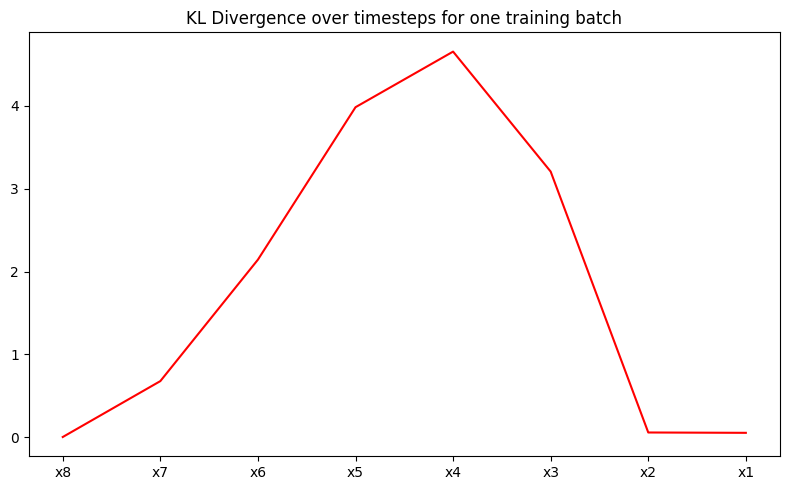

In [6]:
try:
    x0 = x0
except:
    kwargs['n_samples'] = 60
    x0 = next(iter(trainloader))[0][:kwargs['n_samples']].to(kwargs['device'])

#x0 = next(iter(trainloader))[0][:60].to(kwargs['device'])
x0 = x0_large[:60].to(kwargs['device'])

trainer.model.eval()

colors = ['r', 'g', 'b', 'y', 'm', 'c']
kls = []
kl_std = []
plt.figure(figsize=(8, 5))
for i in tqdm(range(kwargs['timesteps']-1, -1, -1), total = kwargs['timesteps'], desc = 'KL Div over timesteps'):
    t = torch.full((60,), i, dtype=torch.long).to(kwargs['device'])
    t2 = t - 1
    xt = sampler.degradation.degrade(x0, t)
    cond = sampler.degradation.degrade(x0, t2)
    pred, kl = trainer.model(xt, t, cond=cond, prior=None, t2=t2)
    pred.detach()
    kls.append(kl.detach().mean().item())
    kl_std.append(kl.detach().std().item())

plt.plot(range(kwargs['timesteps']), kls, color = colors[0])
plt.fill_between(range(kwargs['timesteps']), np.array(kls) - np.array(kl_std), np.array(kls) + np.array(kl_std), alpha=0.2, color=colors[0])
plt.xticks(range(kwargs['timesteps']), ["x" + str(i) for i in range(kwargs['timesteps'],0, -1)])
plt.title(f"KL Divergence over timesteps for one training batch")
plt.tight_layout()
plt.show()

# AutoEncoder Sampling

In [55]:
class AESampler():

    def __init__(self, trainer, **kwargs):
        self.model = trainer.model
        self.trainer = trainer
        self.timesteps = kwargs['timesteps']
        self.T = torch.full((kwargs['n_samples'],), self.timesteps-1, dtype=torch.long).to(kwargs['device'])
        self.xT = torch.zeros((kwargs['n_samples'], self.model.in_channels, kwargs['image_size'], kwargs['image_size']), device=kwargs['device']) 
        self.target_prior = torch.randn(kwargs['n_samples'], kwargs['latent_dim']).to(kwargs['device'])
        self.target_prior = self.target_prior[0, :].unsqueeze(0).repeat(kwargs['n_samples'], 1)
        self.source_prior = torch.randn(kwargs['n_samples'], kwargs['latent_dim']).to(kwargs['device'])
        self.sample_noise = torch.randn(kwargs['n_samples'], self.model.in_channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device'])
        self.add_noise = kwargs['add_noise']

        if kwargs['multiscale_vae']:
            self.target_prior = torch.randn((kwargs['n_samples'], len(self.model.channel_mult), kwargs['latent_dim'])).to(kwargs['device'])
            self.target_prior = self.target_prior[0, :].unsqueeze(0).repeat(kwargs['n_samples'], 1, 1)
            self.source_prior = torch.randn((kwargs['n_samples'], len(self.model.channel_mult), kwargs['latent_dim'])).to(kwargs['device'])

        self.dct = DCTBlurSampling(trainer.degradation.dct_blur.blur_sigmas, kwargs['image_size'], kwargs['device'])

    
    @torch.no_grad()
    def full_loop(self, step_size, injection_t = [200, 50], x0 = None, x02 = None, plot = True, accumulative = True, **kwargs):
        
        xt = self.xT
        samples = torch.Tensor(xt[0:5])
        
        skip_steps = step_size-1 if step_size == self.timesteps else step_size
        
        # Fix sample Noise
        if self.add_noise:
            self.model.sample_noise = self.sample_noise * self.model.noise_scale
        
        # Make accumulative injections, i.e., fix injection beginning to start
        if accumulative:
            if injection_t[0] != -1:
                injection_t[0] = 200

        # Loop differs from the sequential one, as we go back to t-1 at every step
        for i in tqdm(range(self.timesteps-1, -1, -skip_steps), total = self.timesteps // skip_steps, desc = f'Sampling Autoencoder for window {injection_t}'):
            
            t = torch.full((kwargs['n_samples'],), i, dtype=torch.long).to(kwargs['device'])
            t2 = torch.full((kwargs['n_samples'],), i-step_size, dtype=torch.long).to(kwargs['device'])
            
            if t2[0].item() < 0: # Equals to x0 prediction
                t2 = torch.full((kwargs['n_samples'],), -1, dtype=torch.long).to(kwargs['device']) # t-1 to account for 0 indexing that the model is seeing during training

            # Inject source information in a certain t range
            # if x0 and / or x02 are not None, take the conditioning information from the encoded data,
            
            if i < injection_t[0] and i > injection_t[1]:
                if x02 is not None:
                    xt2 = self.trainer.degradation.degrade(x02, t)
                    cond = self.trainer.degradation.degrade(x02, t2)
                    dummy_pred = self.model(xt2, t, cond=cond, prior=None, t2=t2).detach() # Dummy prediction to get the encoded VAE latent
                    z_sem = self.model.z_sem.detach() # Get the latent code for the second image to inject it into the model at a certain timestep
                else:
                    z_sem = None
                    cond = None # No condition for the model, such that is has to use the prior
            else:
                if x0 is not None:
                    cond = self.trainer.degradation.degrade(x0, t2)
                    z_sem = None # No prior for the model, such that it has to use it's own z_sem
                else:
                    cond = None
                    z_sem = None

            # Sample New Noise every time
            #self.model.sample_noise = torch.randn_like(xt).to(xt.device) #* self.model.noise_scale

            pred = self.model(xt, t, cond=cond, prior=z_sem, t2=t2)
            pred = pred.detach()
            
            #xtm1_model = xt + pred
            xtm1_model = pred

            samples = torch.cat((samples, xtm1_model[0:5]), dim=0)
        
            xt = xtm1_model
            #samples = torch.cat((samples, xt[0:5]), dim=0)
            if t[0].item() < step_size:
                break
    
        if plot:
            self.plot(xt)
            save_gif(samples[::5,:,:], f'./imgs/experiment_imgs', nrow = 1, name = f"sample_DCT_{bansal_flag}_{step_size}.gif")

        return samples, xt
    



    def plot(self, input):
        plt.figure(figsize=(20, 10))
        grid = make_grid(input, nrow=10, padding=0)
        grid = torch.clamp(grid, 0, 1)
        plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
        plt.axis('off')
        plt.show()

trainer.model.noise_level = kwargs['noise_scale']
ae_sampler = AESampler(trainer, **kwargs)


In [7]:
ae_sampler.model.noise_scale = 0.005

use_x0 = True
use_x02 = True
num_rows = 0
img_ind = 0

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(style_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 20
gridlist = []
for inject_interval in [[200,-1], [-1,200], [200,160], [160,120], [120, 80], [80, 40], [40, -1]]:
    
    samples, xt = ae_sampler.full_loop(step_size, 
                                          injection_t = inject_interval, 
                                          x0 = x0,
                                          x02 = x02,
                                          plot = False, 
                                          accumulative = True,
                                          **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

gridlist.append(plot_grid)

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

NameError: name 'ae_sampler' is not defined

Sampling Autoencoder for window [200, -1]:  90%|█████████ | 9/10 [00:02<00:00,  3.29it/s]


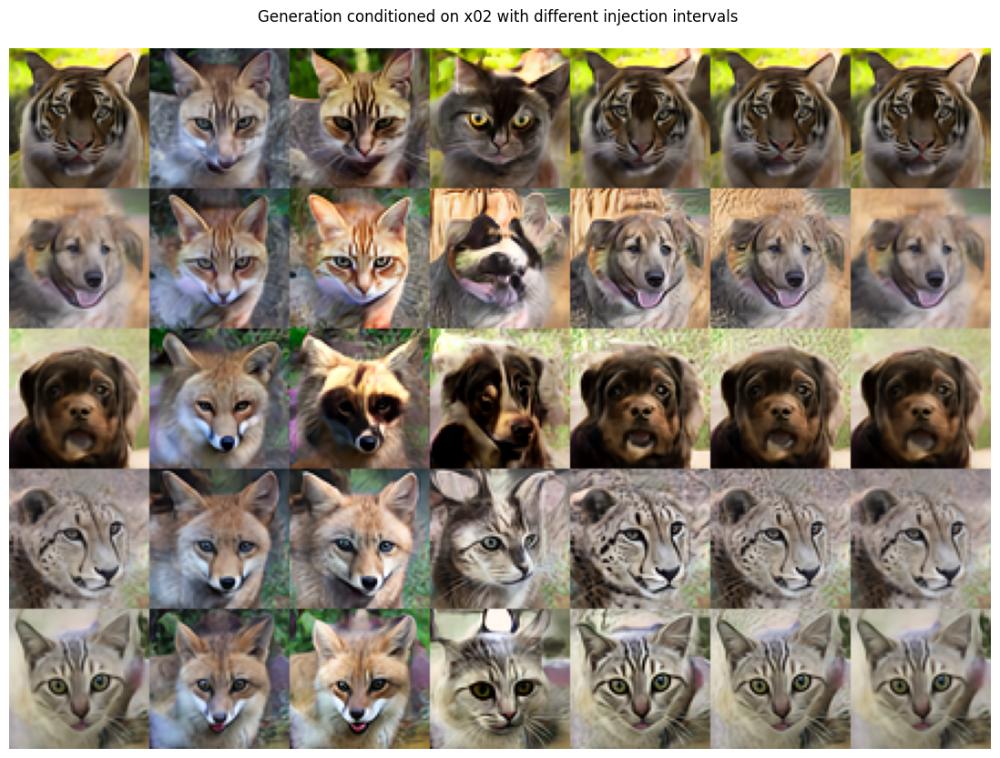

In [52]:
use_x0 = True
use_x02 = True
num_rows = 0
img_ind = 0

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(style_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 20
gridlist = []
for inject_interval in [[200,-1], [-1,200], [200,160], [160,120], [120, 80], [80, 40], [40, -1]]:
    
    samples, xt = ae_sampler.full_loop(step_size, 
                                          injection_t = inject_interval, 
                                          x0 = x0,
                                          x02 = x02,
                                          plot = False, 
                                          accumulative = True,
                                          **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

gridlist.append(plot_grid)

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()

Sampling Autoencoder for window [20, -1]:  90%|█████████ | 9/10 [00:02<00:00,  3.44it/s]


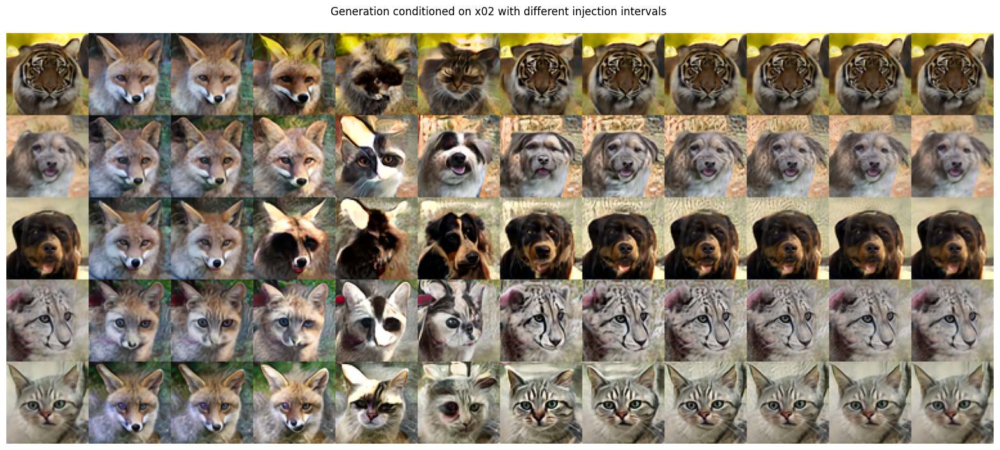

In [48]:

use_x0 = True
use_x02 = True
num_rows = 0
img_ind = 0

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(style_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 20
gridlist = []
for inject_interval in [[200,-1], [-1,200], [200,180], [180,160], [160, 140], [140, 120], [120, 100], [100, 80], [80, 60], [60, 40], [40, 20], [20, -1]]:
    
    samples, xt = ae_sampler.full_loop(step_size, 
                                          injection_t = inject_interval, 
                                          x0 = x0,
                                          x02 = x02,
                                          plot = False, 
                                          accumulative = True,
                                          **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

gridlist.append(plot_grid)

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()


Sampling Autoencoder for window [20, -1]:  90%|█████████ | 9/10 [00:01<00:00,  4.94it/s]


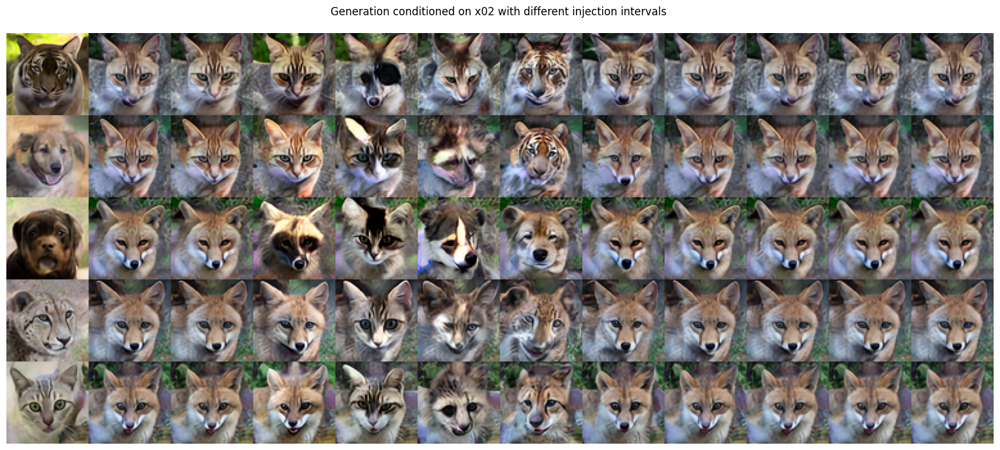

In [51]:

use_x0 = True
use_x02 = True
num_rows = 0
img_ind = 0

# Load Data
if use_x0:
    x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    x0[1:kwargs['n_samples']] = x0[0].unsqueeze(0).repeat(kwargs['n_samples']-1, 1, 1, 1) # Set x0 to be the same for all samples
else:
    x0 = None
if use_x02:
    x02 = x02_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
    plot_grid = torch.Tensor(x02[0:5]).unsqueeze(0)
    title_flag = "Generation conditioned on x02"
else:
    x02 = None
    plot_grid = torch.Tensor(style_sampler.xT[0:5]).unsqueeze(0)
    title_flag = "Unconditional Generation"
    


step_size = 20
gridlist = []
for inject_interval in [[200,-1], [-1,200], [200,180], [180,160], [160, 140], [140, 120], [120, 100], [100, 80], [80, 60], [60, 40], [40, 20], [20, -1]]:
    
    samples, xt = ae_sampler.full_loop(step_size, 
                                          injection_t = inject_interval, 
                                          x0 = x0,
                                          x02 = x02,
                                          plot = False, 
                                          accumulative = False,
                                          **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:5].unsqueeze(0)), dim=0)
    num_rows += 1

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

gridlist.append(plot_grid)

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()


# VXT Encoding Monitor - check KL Divergence over timesteps

KL Div at different timesteps: 100%|██████████| 6/6 [00:27<00:00,  4.57s/it]


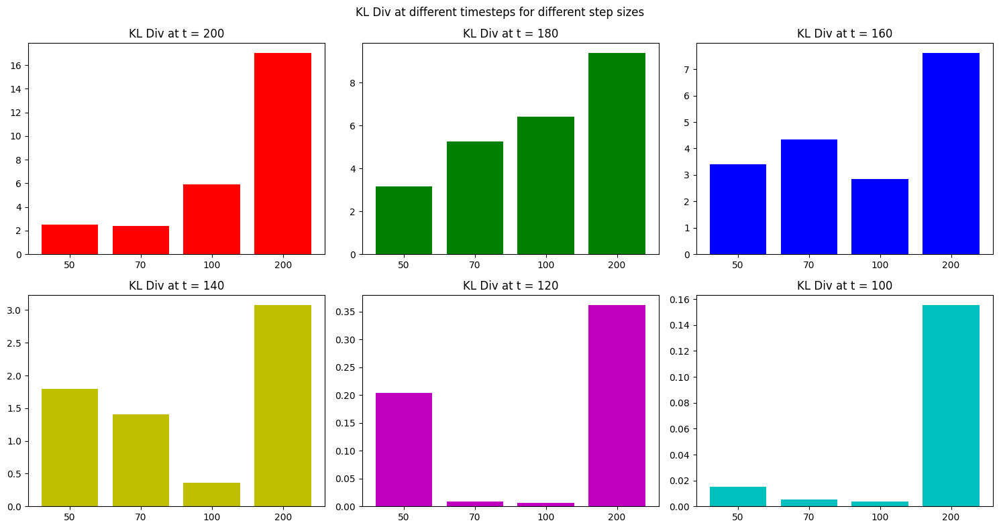

In [34]:
try:
    x0 = x0
except:
    x0 = next(iter(trainloader))[0][:kwargs['n_samples']].to(kwargs['device'])

trainer.model.eval()

starts = [200, 180, 160, 140, 120, 100]
steps = [50, 70, 100, 200]

colors = ['r', 'g', 'b', 'y', 'm', 'c']

plt.figure(figsize=(15, 8))
for i, start in tqdm(enumerate(starts), total = len(starts), desc = "KL Div at different timesteps"):
    t = torch.full((kwargs['n_samples'],), start, dtype=torch.long).to(kwargs['device'])

    kls = []
    for step in steps:
        t2 = torch.full((kwargs['n_samples'],), start - step, dtype=torch.long).to(kwargs['device'])
        cond = sampler.degradation.degrade(x0, t2)
        pred = trainer.model(x0, t, cond=cond, prior=None, t2=t2)
        pred.detach()
        kls.append(trainer.model.kl_div.detach().mean().item())

    plt.subplot(2, int(len(starts)/2), i+1)
    plt.bar(range(len(steps)), kls, label=f"KL Div at t = {start}", color = colors[i])
    plt.title(f"KL Div at t = {start}")
    plt.xticks(range(len(steps)), steps)

plt.suptitle("KL Div at different timesteps for different step sizes")
plt.tight_layout()
plt.show()

# DDPM Latent Injection Sampling

In [42]:
class DDPMSampler():

    def __init__(self, trainer, **kwargs):
        self.model = trainer.model
        self.trainer = trainer
        self.timesteps = kwargs['timesteps']
        self.T = torch.full((kwargs['n_samples'],), self.timesteps-1, dtype=torch.long).to(kwargs['device'])
        self.target_priors = torch.randn(kwargs['timesteps'], kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device'])
        self.target_priors = self.target_priors[:,0,:,:,:].unsqueeze(1).repeat(1, kwargs['n_samples'], 1, 1, 1) # Set x0 to be the same for all samples
        self.source_priors = torch.randn(kwargs['timesteps'], kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device'])

    
    @torch.no_grad()
    def full_loop(self, injection_t = [200, 50], plot = False, **kwargs):

        self.model.eval()


        x_t = self.target_priors[-1]
        samples = torch.Tensor(x_t[0:10])

        for t in tqdm(reversed(range(self.timesteps)), desc="DDPM Sampling"):

            t_tensor = torch.full((kwargs['n_samples'],), t).to(kwargs['device'])

            # Inject source information in a certain t range
            if t < injection_t[0] and t > injection_t[1]:
                z = self.source_priors[t]
            else:
                z = self.target_priors[t]

            #z = torch.randn_like(z)
            posterior_mean_x0, posterior_mean_xt, posterior_var = self.trainer.reconstruction.coefs.posterior(t_tensor) # Get coefficients for the posterior distribution q(x_{t-1} | x_t, x_0)
            model_pred = self.model(x_t, t_tensor)
            x_0_hat = self.trainer.reconstruction.reform_pred(model_pred, x_t, t_tensor, return_x0 = True) # Obtain the estimate of x_0 at time t to sample from the posterior distribution q(x_{t-1} | x_t, x_0)
            x_0_hat.clamp_(-1, 1) # Clip the estimate to the range [-1, 1]

            x_t_m1 = posterior_mean_xt * x_t + posterior_mean_x0 * x_0_hat + torch.sqrt(posterior_var) * z # Sample x_{t-1} from the posterior distribution q(x_{t-1} | x_t, x_0)

            x_t = x_t_m1
                
        samples = torch.cat((samples, x_t[0:10]), dim=0)
    
        
        if plot:
            self.plot(x_t)
            save_gif(samples[::5,:,:], f'./imgs/experiment_imgs', nrow = 1, name = f"sample_DCT_{bansal_flag}_{step_size}.gif")

        return samples, x_t
    



    def plot(self, input):
        plt.figure(figsize=(20, 10))
        grid = make_grid(input, nrow=10, padding=0)
        grid = torch.clamp(grid, 0, 1)
        plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
        plt.axis('off')
        plt.show()


ddpm_sampler = DDPMSampler(trainer, **kwargs)

DDPM Sampling: 200it [00:27,  7.34it/s]
DDPM Sampling: 200it [00:21,  9.39it/s]
DDPM Sampling: 200it [00:18, 10.79it/s]
DDPM Sampling: 200it [00:18, 10.80it/s]
DDPM Sampling: 200it [00:19, 10.51it/s]
DDPM Sampling: 200it [00:18, 10.96it/s]


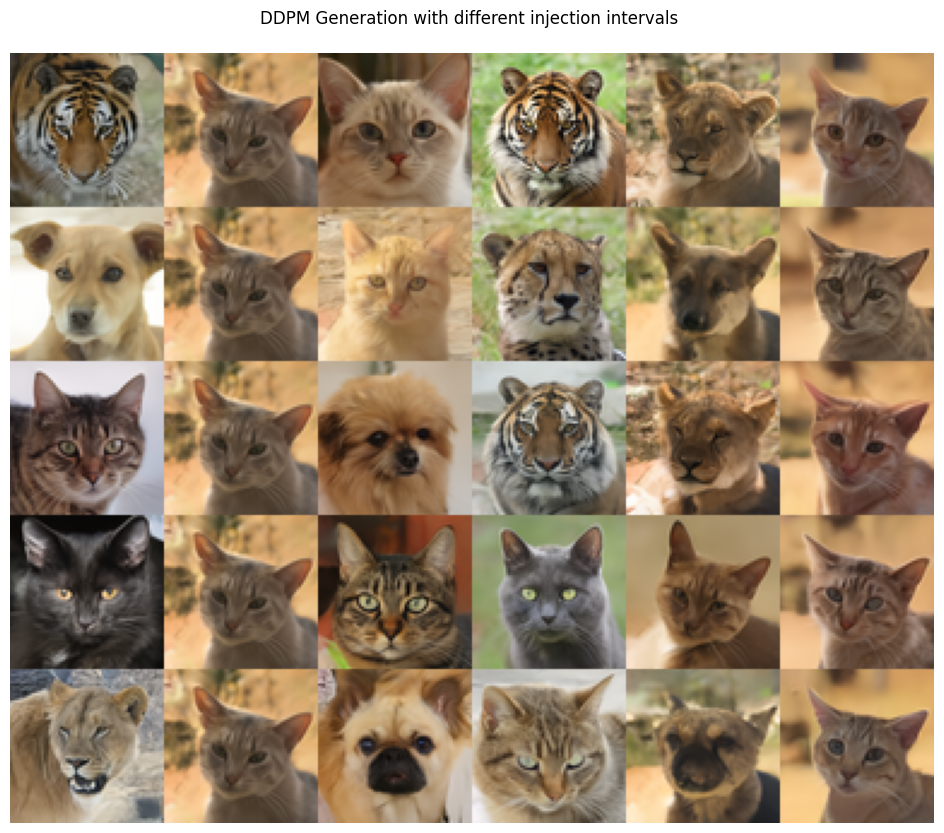

In [43]:

plot_grid = torch.Tensor(ddpm_sampler.target_priors[-1][0:5]).unsqueeze(0)
title_flag = "DDPM Generation"
num_rows = 6

step_size = 1
gridlist = []
for inject_interval in [[200,-1], [-1,200], [200,175], [175,130], [130, 70], [70,-1]]:
    
    samples, xt = ddpm_sampler.full_loop(injection_t = inject_interval, 
                                          plot = False, 
                                          **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:10].unsqueeze(0)), dim=0)

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

gridlist.append(plot_grid)

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()



# RISANNEN Latent Injection Sampling

In [10]:
class RisannenSampler():

    def __init__(self, trainer, **kwargs):
        self.model = trainer.model
        self.trainer = trainer
        self.timesteps = kwargs['timesteps']
        self.T = torch.full((kwargs['n_samples'],), self.timesteps-1, dtype=torch.long).to(kwargs['device'])
        self.xT = torch.zeros((kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']), device=kwargs['device'])
        self.target_priors = torch.randn(kwargs['timesteps'], kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device'])
        
        self.target_priors = self.target_priors[:,0,:,:,:].unsqueeze(1).repeat(1, kwargs['n_samples'], 1, 1, 1) # Set x0 to be the same for all samples

        self.source_priors = torch.randn(kwargs['timesteps'], kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device'])
        self.target_prior = torch.randn(kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device'])
        self.source_prior = torch.randn(kwargs['n_samples'], channels, kwargs['image_size'], kwargs['image_size']).to(kwargs['device'])
        self.xT += self.target_priors[-1] * kwargs['noise_scale'] 
        self.dct = DCTBlurSampling(trainer.degradation.dct_blur.blur_sigmas, kwargs['image_size'], kwargs['device'])

    
    @torch.no_grad()
    def full_loop(self, step_size, injection_t = [200, 50], plot = True, bansal_sampling = False, **kwargs):
        
        xt = self.xT
        samples = torch.Tensor(xt[0:5])
        
        # Bansal-style sampling
        if bansal_sampling:
            skip_steps = 1
            bansal_flag = "Bansal"
        else:
            skip_steps = step_size-1 if step_size == self.timesteps else step_size
            bansal_flag = "Regular"
            
        # Loop differs from the sequential one, as we go back to t-1 at every step
        for i in tqdm(range(self.timesteps-1, -1, -skip_steps), total = self.timesteps // skip_steps, desc = f'Sampling {bansal_flag} with step size of {step_size}'):
            
            t = torch.full((kwargs['n_samples'],), i, dtype=torch.long).to(kwargs['device'])
            t2 = torch.full((kwargs['n_samples'],), i-step_size, dtype=torch.long).to(kwargs['device'])
            
            if t2[0].item() < 0: # Equals to x0 prediction
                t2 = torch.full((kwargs['n_samples'],), -1, dtype=torch.long).to(kwargs['device']) # t-1 to account for 0 indexing that the model is seeing during training

            # if not bansal_sampling:
            #     print(f"t = {t[0].item()}, t2 = {t2[0].item()}")
            
            # Inject source information in a certain t range
            # if x0 and / or x02 are not None, take the conditioning information from the encoded data,
            if i < injection_t[0] and i > injection_t[1]:
                prior = self.source_priors[i]
            else:
                prior = self.target_priors[i]

            pred = self.model(xt, t, t2=None)
            pred = pred.detach()
            
            xtm1_model = xt + pred

            # In Risannen the noise is added to the predicted image, AFTER the model prediction
            if not i == 0:
                sampling_noise = prior * kwargs['noise_scale'] * 1.25 # Add noise to the predicted image
                xtm1_model = xtm1_model + sampling_noise

            # Bansal Part
            if bansal_sampling:
                if step_size == self.timesteps:
                    
                    xt_hat = self.trainer.degradation.degrade(xtm1_model, t)
                    xtm1_hat = self.trainer.degradation.degrade(xtm1_model, t-1)
                    
                else:

                    # Calculcate reblurring for DCT
                    stdt = self.trainer.degradation.blur.dct_sigmas[t[0].item()]
                    stdtm1 = self.trainer.degradation.blur.dct_sigmas[t[0].item()-1]
                    stdt2 = self.trainer.degradation.blur.dct_sigmas[t2[0].item()] if t2[0].item() != -1 else 0

                    # Manually calculating DCT timesteps
                    t_dct = torch.full((kwargs['n_samples'],), stdt**2/2, dtype=torch.float32)[:, None, None, None].to(kwargs['device'])
                    tm1_dct = torch.full((kwargs['n_samples'],), stdtm1**2/2, dtype=torch.float32)[:, None, None, None].to(kwargs['device'])
                    t2_dct = torch.full((kwargs['n_samples'],), stdt2**2/2, dtype=torch.float32)[:, None, None, None].to(kwargs['device'])
                    
                    # Calculate DCT differences to get to t / t-1 from t2
                    t_diff_dct = t_dct - t2_dct
                    tm1_diff_dct = tm1_dct - t2_dct

                    print("Before Unblacking:", xtm1_model.mean())

                    # Undo Blacking
                    blacking_coef = self.trainer.degradation.blacking_coefs[t2[0].item()] if t2[0].item() != -1 else 1
                    xtm1_model = xtm1_model / blacking_coef
                    print(blacking_coef)
                    print("After Unblacking:", xtm1_model.mean())

                    # Reblur to t / t-1 from t2
                    xt_hat = self.dct(xtm1_model, t=t_diff_dct) 
                    if tm1_diff_dct[0].item() != 0:
                        xtm1_hat = self.dct(xtm1_model, t=tm1_diff_dct)
                    else:
                        xtm1_hat = xtm1_model

                    # Reapply Blacking
                    xt_hat = xt_hat * self.trainer.degradation.blacking_coefs[t[0].item()]
                    xtm1_hat = xtm1_hat * self.trainer.degradation.blacking_coefs[t[0].item() - 1]

                    print("After Reblacking:", xtm1_hat.mean())

                    if t[0].item()-1 == -1:
                        xtm1_hat = xtm1_model # Keep the original image for t=-1 (needed for Bansal style sampling)
                        #assert torch.equal(xtm1_hat[0], xtm1_model[0]), f"DCT reblurring failed, xtm1_hat is not equal to xtm1_model with xtm1_hat = {xtm1_hat[0,0,0]} and xtm1_model = {xtm1_model[0,0,0]}"
                    
                    # Check for NAs
                    if torch.isnan(xtm1_hat).any():
                        print("NAs in xtm1_hat")
                        self.investigate = [xt, xtm1_model, xtm1_hat]
                        plt.imshow(xt[0].cpu().detach().numpy().transpose(1, 2, 0)) 

                    assert not torch.isnan(xtm1_hat).any() 

                xt = xt - xt_hat + xtm1_hat # Counter the bias of the model prediction by having it incorporated two times in the sampling process
            
                print("Scales of the all:", xt.mean(), xt_hat.mean(), xtm1_hat.mean())

            else:
                xt = xtm1_model
                #samples = torch.cat((samples, xt[0:5]), dim=0)

                if t[0].item() < step_size:
                    break
            

            
            samples = torch.cat((samples, xt[0:5]), dim=0)

        
        if plot:
            self.plot(xt)
            save_gif(samples[::5,:,:], f'./imgs/experiment_imgs', nrow = 1, name = f"sample_DCT_{bansal_flag}_{step_size}.gif")

        return samples, xt
    



    def plot(self, input):
        plt.figure(figsize=(20, 10))
        grid = make_grid(input, nrow=10, padding=0)
        grid = torch.clamp(grid, 0, 1)
        plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
        plt.axis('off')
        plt.show()

kwargs['noise_scale'] = 0.01
risannen_sampler = RisannenSampler(trainer, **kwargs)

Sampling Regular with step size of 1: 100%|█████████▉| 199/200 [02:48<00:00,  1.18it/s]


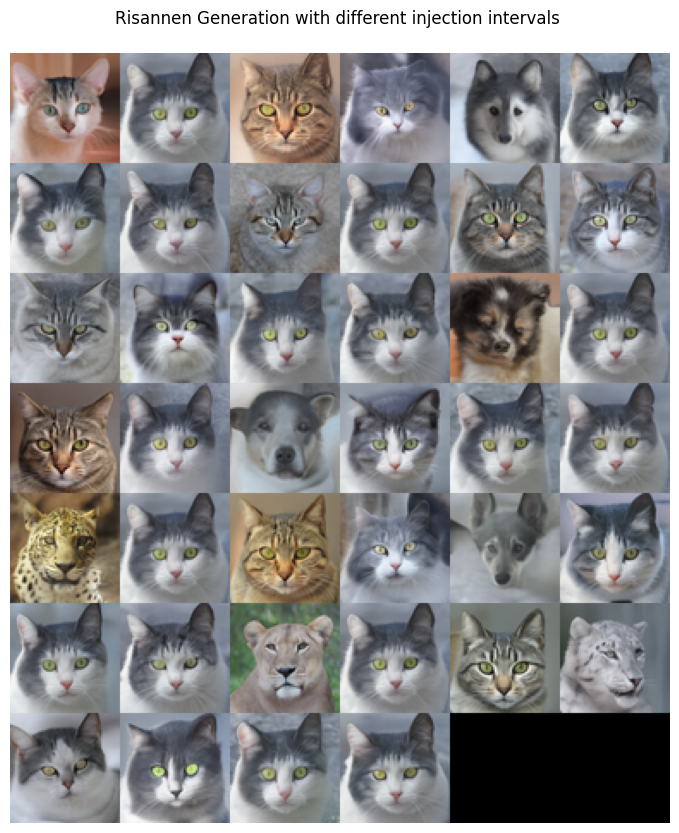

In [13]:

plot_grid = torch.Tensor(risannen_sampler.target_priors[-1][0:5]).unsqueeze(0)
#plot_grid = torch.Tensor(risannen_sampler.target_prior[0:5]).unsqueeze(0)
risannen_sampler.model.sample_noise = None

title_flag = "Risannen Generation"
num_rows = 6

step_size = 1
gridlist = []
for inject_interval in [[200,-1], [-1,200], [200,170], [170,150], [150,120], [120, 90], [90, 60], [60,-1]]:
    
    samples, xt = risannen_sampler.full_loop(step_size=step_size,
                                            injection_t = inject_interval, 
                                            bansal_sampling=False,
                                            plot = False, 
                                            **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:10].unsqueeze(0)), dim=0)

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

gridlist.append(plot_grid)

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()



Sampling Regular with step size of 1: 100%|█████████▉| 199/200 [00:21<00:00,  9.30it/s]


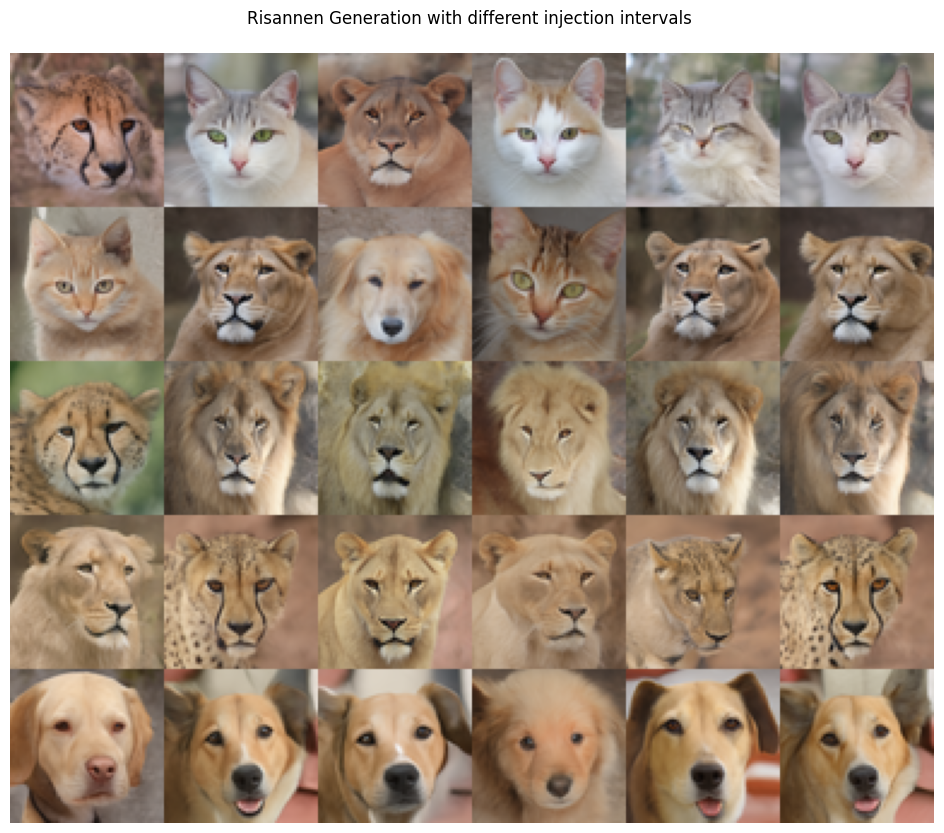

In [20]:

plot_grid = torch.Tensor(risannen_sampler.target_priors[-1][0:5]).unsqueeze(0)
#plot_grid = torch.Tensor(risannen_sampler.target_prior[0:5]).unsqueeze(0)

title_flag = "Risannen Generation"
num_rows = 6

step_size = 1
gridlist = []
for inject_interval in [[200,-1], [-1,200], [200,160], [160,110], [110, 60], [60,-1]]:
    
    samples, xt = risannen_sampler.full_loop(step_size=step_size,
                                            injection_t = inject_interval, 
                                            bansal_sampling=False,
                                            plot = False, 
                                            **kwargs)
    
    plot_grid = torch.cat((plot_grid, xt[:10].unsqueeze(0)), dim=0)

plot_grid = torch.transpose(plot_grid, 0, 1) # Transpose to switch cols and rows in the grid
#if not use_x:
plot_grid = plot_grid[:,1:,:,:,:] # Remove first xT
plot_grid = plot_grid.reshape(-1, channels, kwargs['image_size'], kwargs['image_size'])

gridlist.append(plot_grid)

plt.figure(figsize=(20, 10))
grid = make_grid(plot_grid, nrow=num_rows, padding=0)
grid = torch.clamp(grid, 0, 1)
plt.imshow(grid.cpu().detach().numpy().transpose(1, 2, 0))
plt.axis('off')
plt.title(f"{title_flag} with different injection intervals \n")
plt.show()



# Degradation Display

In [18]:
import dct_blur as torch_dct

class DCTBlur(nn.Module):

    def __init__(self, blur_sigmas, image_size, device):
        super(DCTBlur, self).__init__()
        self.blur_sigmas = blur_sigmas.clone().detach().to(device)
        freqs = np.pi*torch.linspace(0, image_size-1,
                                    image_size).to(device)/image_size
        self.frequencies_squared = freqs[:, None]**2 + freqs[None, :]**2

    def forward(self, x, fwd_steps):
        if len(x.shape) == 4:
            sigmas = self.blur_sigmas[fwd_steps][:, None, None, None]
        elif len(x.shape) == 3:
            sigmas = self.blur_sigmas[fwd_steps][:, None, None]
        t = sigmas**2/2
        dct_coefs = torch_dct.dct_2d(x, norm='ortho')
        dct_coefs = dct_coefs * torch.exp(- self.frequencies_squared * t)
        dct_blurred = torch_dct.idct_2d(dct_coefs, norm='ortho')
        dct_blurred[fwd_steps == -1] = x[fwd_steps == -1] # Keep the original image for t=-1 (needed for Bansal style sampling)
        return dct_blurred


dct_sigma_min = 1
dct_sigma_max = 64
dct_sigmas = torch.exp(torch.linspace(np.log(dct_sigma_min),
                                        np.log(dct_sigma_max), kwargs['timesteps'] + 1, device=kwargs['device']))

#dct_sigmas = torch.linspace(dct_sigma_min, dct_sigma_max, kwargs['timesteps'] + 1, device=kwargs['device'])


In [16]:
kwargs['degradation'] = 'blur'
kwargs['timesteps'] = 8
trainer = Trainer(unet, **kwargs)

In [240]:
dct_sigmas

tensor([ 0.5000,  1.1225,  2.5198,  5.6569, 12.6992, 28.5088, 64.0000, 64.0000])

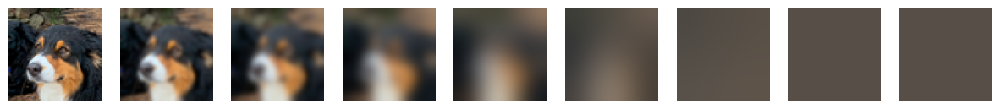

In [28]:
img_ind = 1
x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
dct_sigmas = torch.exp(torch.linspace(np.log(dct_sigma_min),
                                        np.log(dct_sigma_max), kwargs['timesteps']-1, device=kwargs['device']))
dct_sigmas = torch.cat((dct_sigmas, torch.ones(1).to(kwargs['device']) * dct_sigmas[-1]))

trainer.degradation.dct_blur = DCTBlur(dct_sigmas, 64, kwargs['device'])

plt.figure(figsize=(15, 2))
for i in range(0, kwargs['timesteps']+1, 1):
    t = torch.full((5,), i-1).to(kwargs['device'])
    degraded = trainer.degradation.dct_blur(x0, t)
    #black_coef = trainer.degradation.blacking_coefs[t[0].item()] if t[0].item() != -1 else 1
    unblacked_degraded = degraded #/ black_coef
    plt.subplot(1, kwargs['timesteps'] + 1, i+1)
    plt.imshow(unblacked_degraded[1].cpu().detach().numpy().transpose(1, 2, 0))

    # Turn off axes
    plt.axis('off')

plt.show()


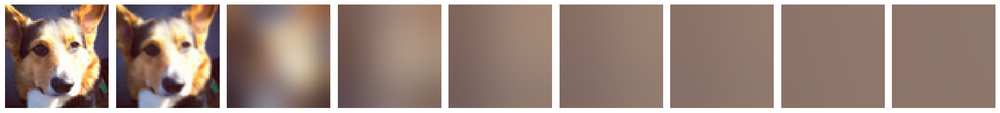

In [219]:
x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
dct_sigmas = torch.linspace(dct_sigma_min, dct_sigma_max, kwargs['timesteps'] + 1, device=kwargs['device'])
trainer.degradation.dct_blur = DCTBlur(dct_sigmas, 64, kwargs['device'])

plt.figure(figsize=(20, 7))
for i in range(0, kwargs['timesteps']+1, 1):
    t = torch.full((5,), i-1).to(kwargs['device'])
    degraded = trainer.degradation.dct_blur(x0, t)
    #black_coef = trainer.degradation.blacking_coefs[t[0].item()] if t[0].item() != -1 else 1
    unblacked_degraded = degraded #/ black_coef
    plt.subplot(1, kwargs['timesteps'] + 1, i+1)
    plt.imshow(unblacked_degraded[1].cpu().detach().numpy().transpose(1, 2, 0))
    # Turn off axes
    plt.axis('off')

plt.tight_layout()
plt.show()


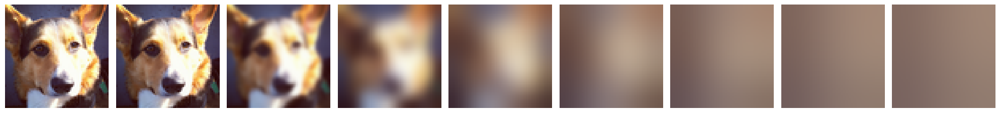

In [217]:
x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
coefs = trainer.degradation.blur.scheduler.cosine(timesteps, black=True)
#reverse
coefs = 1 - coefs 
coefs = torch.cat((coefs, torch.ones(1).to(kwargs['device'])))
dct_sigma_max = 32
dct_sigmas  = dct_sigma_max * coefs

trainer.degradation.dct_blur = DCTBlur(dct_sigmas, 64, kwargs['device'])

plt.figure(figsize=(20, 7))
for i in range(0, kwargs['timesteps']+1, 1):
    t = torch.full((5,), i-1).to(kwargs['device'])
    degraded = trainer.degradation.dct_blur(x0, t)
    #black_coef = trainer.degradation.blacking_coefs[t[0].item()] if t[0].item() != -1 else 1
    unblacked_degraded = degraded #/ black_coef
    plt.subplot(1, kwargs['timesteps'] + 1, i+1)
    plt.imshow(unblacked_degraded[1].cpu().detach().numpy().transpose(1, 2, 0))
    # Turn off axes
    plt.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
# 

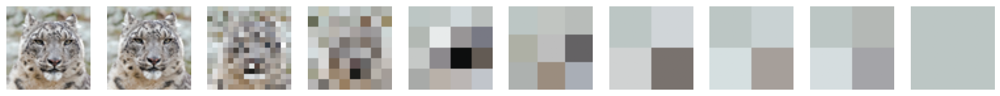

In [36]:
# Define Pixelation degrader
from torch.nn import functional as F

def pixelate(x, t):
    t = t[0].item()
    og_shape = x.shape
    x = F.interpolate(x, scale_factor=1/t, mode='nearest')
    x = F.interpolate(x, size=og_shape[2:], mode='nearest')
    return x

n_samples = 10
#t_max = image_size / 2 + 1
#pixelations = torch.linspace(0.01, 32 + 1, n_samples)
pixel_coefs = trainer.schedule.cosine(n_samples, black=True)
pixelations = (1 - pixel_coefs)*(32+1)
pixelations = [max(int(pix), 0.1) for pix in pixelations]

plt.figure(figsize=(20, 7))
for i, pixel in enumerate(pixelations):
    x = pixelate(x0, torch.full((n_samples,), pixel))
    plt.subplot(1, len(pixelations), i+1)
    plt.imshow(x[1].cpu().detach().numpy().transpose(1, 2, 0))
    plt.axis('off')

plt.show()



In [ ]:
x0 = x0_large[kwargs['n_samples']*(img_ind):kwargs['n_samples']*(img_ind+1)]
coefs = trainer.degradation.blur.scheduler.cosine(timesteps, black=True)
#reverse
coefs = 1 - coefs 
coefs = torch.cat((coefs, torch.ones(1).to(kwargs['device'])))
dct_sigma_max = 32
dct_sigmas  = dct_sigma_max * coefs

trainer.degradation.dct_blur = DCTBlur(dct_sigmas, 64, kwargs['device'])

plt.figure(figsize=(20, 7))
for i in range(0, kwargs['timesteps']+1, 1):
    t = torch.full((5,), i-1).to(kwargs['device'])
    degraded = trainer.degradation.dct_blur(x0, t)
    #black_coef = trainer.degradation.blacking_coefs[t[0].item()] if t[0].item() != -1 else 1
    unblacked_degraded = degraded #/ black_coef
    plt.subplot(1, kwargs['timesteps'] + 1, i+1)
    plt.imshow(unblacked_degraded[1].cpu().detach().numpy().transpose(1, 2, 0))
    # Turn off axes
    plt.axis('off')

plt.tight_layout()
plt.show()


In [44]:
trainer = Trainer(unet, **kwargs)

trainer.degradation.pixel_coefs = [1, 2, 3, 4, 8, 13, 19, 24, 32, 33]

trainer.degradation.pixel_coefs = torch.exp(torch.linspace(np.log(1.5), np.log(kwargs['image_size']/2 + 5), 10))
trainer.degradation.pixel_coefs = [int(pix) for pix in trainer.degradation.pixel_coefs]

In [43]:
trainer.degradation.pixel_coefs

[1, 2, 2, 3, 4, 6, 8, 11, 15, 21]

In [34]:
trainer.degradation.pixel_coefs

[1, 2, 3, 4, 6, 9, 13, 20, 29, 42]

5
0
1
2
3
4
5
0
1
2
3
4
5
0
1
2
3
4
5
0
1
2
3
4
5
0
1
2
3
4
5
0
1
2
3
4
5
0
1
2
3
4
5
0
1
2
3
4
5
0
1
2
3
4
5
0
1
2
3
4
5
0
1
2
3
4


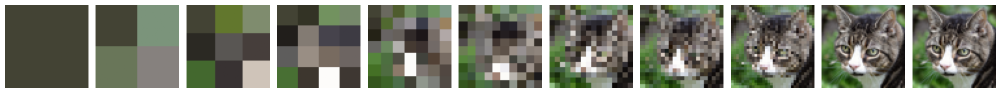

In [35]:

plt.figure(figsize=(20, 7))
for j, i in enumerate(range(kwargs['timesteps'], -1, -1)):
    t = torch.full((5,), i-1).to(kwargs['device'])
    degraded = trainer.degradation.degrade(x0, t)
    plt.subplot(1, kwargs['timesteps'] + 1, j+1)
    plt.imshow(degraded[4].cpu().detach().numpy().transpose(1, 2, 0))
    # Turn off axes
    plt.axis('off')

plt.tight_layout()
plt.show()
